In [6]:
import sys
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="dark",color_codes=True)
import sklearn
from sklearn.cluster import KMeans

In [7]:
# Before clustering, let's find out the number of clusters that we need to apply

In [8]:
# Finding optimum number of clusters using The Elbow Method

from sklearn.cluster import KMeans
clust = dataa.iloc[:, 35:37].values
wcss = []

for i in range(1,5):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans.fit(clust)
    wcss.append(kmeans.inertia_)
plt.plot(range(1,5),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

NameError: name 'dataa' is not defined

[[2237.66666667]
 [4105.40540541]
 [1209.26966292]]
     data_index  cluster
0             0        0
2             2        0
3             3        0
6             6        0
7             7        0
8             8        0
9             9        0
11           11        0
12           12        0
13           13        0
16           16        0
18           18        0
21           21        0
23           23        0
24           24        0
26           26        0
29           29        0
31           31        0
32           32        0
36           36        0
40           40        0
44           44        0
48           48        0
50           50        0
51           51        0
54           54        0
56           56        0
58           58        0
61           61        0
63           63        0
..          ...      ...
96           96        0
97           97        0
99           99        0
109         109        0
111         111        0
115         115        

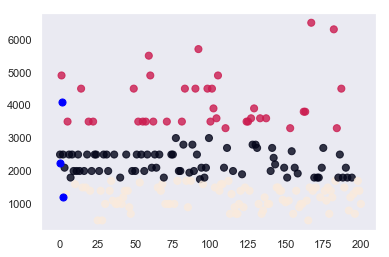

In [9]:
#Clustering - 
dataa = pd.read_csv("final.csv")
dataa = pd.DataFrame(dataa)

#print(dataa.head())

Data = pd.DataFrame(dataa,columns = ['Rent'])

import sklearn
from sklearn.cluster import KMeans

#print(Data)

# 3 clusters
kmeans = KMeans(n_clusters=3).fit(Data)
centroids = kmeans.cluster_centers_
print(centroids)
centroids = pd.DataFrame(centroids)
X= Data['Rent']


cluster_map = pd.DataFrame()
cluster_map['data_index'] = Data.index.values
cluster_map['cluster'] = kmeans.labels_

print(cluster_map[cluster_map.cluster == 0])
print(cluster_map[cluster_map.cluster == 1])
print(cluster_map[cluster_map.cluster == 2])

#plt.scatter(Data.index, X, c= kmeans.labels_.astype(float), s=50, alpha=0.5)
#plt.scatter(centroids.index,centroids, c='red', s=50)

plt.scatter(Data.index, X, c= kmeans.labels_.astype(float), s=50, alpha = 0.8)
plt.scatter(centroids.index,centroids, c='blue', s=50)


In [10]:
#Creating Dummy Variables for categorical features

l = ["EnrolmentTerm","BuildingType","RoomType","Furnished","SharedorPrivate","HouseAge","LocationWard"]
one_hot = pd.get_dummies(dataa[l])
dataa = dataa.drop(l,axis = 1)
dataa = one_hot.join(dataa)
print(dataa.head())
print(dataa.columns)


   EnrolmentTerm_Fall  EnrolmentTerm_Spring  EnrolmentTerm_Winter  \
0                   1                     0                     0   
1                   1                     0                     0   
2                   1                     0                     0   
3                   1                     0                     0   
4                   0                     0                     1   

   BuildingType_Apartment  BuildingType_House  RoomType_Basement  \
0                       1                   0                  0   
1                       1                   0                  0   
2                       0                   1                  0   
3                       0                   1                  0   
4                       1                   0                  0   

   RoomType_Master Room  RoomType_Other  RoomType_Regular Room  Furnished_No  \
0                     0               0                      1             0   
1               

In [11]:
dataa.head()

,EnrolmentTerm_Fall,EnrolmentTerm_Spring,EnrolmentTerm_Winter,BuildingType_Apartment,BuildingType_House,RoomType_Basement,RoomType_Master Room,RoomType_Other,RoomType_Regular Room,Furnished_No,...,AirConditioning,Laundry,Parking,Terrace,Security,Bedrooms,Bathrooms,MarketCommute,BusStopCommute,Rent
0,1,0,0,1,0,0,0,0,1,0,...,1,1,1,0,0,5,2,25,3,2500
1,1,0,0,1,0,0,0,0,1,0,...,0,0,0,1,0,7,3,25,18,4900
2,1,0,0,0,1,0,0,0,1,0,...,1,1,1,1,0,5,2,15,3,2500
3,1,0,0,0,1,0,0,0,1,0,...,1,1,0,0,0,3,1,25,8,2100
4,0,0,1,1,0,0,0,0,1,1,...,0,0,0,1,0,1,1,15,3,1300


In [12]:
new_data = dataa.iloc[:, 0:32]
new_data.head()

,EnrolmentTerm_Fall,EnrolmentTerm_Spring,EnrolmentTerm_Winter,BuildingType_Apartment,BuildingType_House,RoomType_Basement,RoomType_Master Room,RoomType_Other,RoomType_Regular Room,Furnished_No,...,LocationWard_7- Uptown ward,LocationWard_Central-Columbia ward,LocationWard_Southeast ward,Internet,Hydro,AirConditioning,Laundry,Parking,Terrace,Security
0,1,0,0,1,0,0,0,0,1,0,...,0,1,0,1,1,1,1,1,0,0
1,1,0,0,1,0,0,0,0,1,0,...,0,0,1,0,1,0,0,0,1,0
2,1,0,0,0,1,0,0,0,1,0,...,0,1,0,1,1,1,1,1,1,0
3,1,0,0,0,1,0,0,0,1,0,...,1,0,0,1,1,1,1,0,0,0
4,0,0,1,1,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,1,0


In [13]:
from mlxtend.preprocessing import TransactionEncoder
from mlxtend.frequent_patterns import apriori

In [14]:
fme = apriori(new_data, min_support=0.1, use_colnames=True)
fme


,support,itemsets
0,0.512438,(EnrolmentTerm_Fall)
1,0.283582,(EnrolmentTerm_Spring)
2,0.203980,(EnrolmentTerm_Winter)
3,0.696517,(BuildingType_Apartment)
4,0.303483,(BuildingType_House)
5,0.213930,(RoomType_Master Room)
6,0.671642,(RoomType_Regular Room)
7,0.184080,(Furnished_No)
8,0.815920,(Furnished_Yes)
9,0.273632,(SharedorPrivate_Private)


In [22]:
from mlxtend.frequent_patterns import association_rules

temp = association_rules(fme, metric="confidence", min_threshold=0.7)

#http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/association_rules/

In [ ]:
# End of this file

In [23]:
temp

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(EnrolmentTerm_Fall),(RoomType_Regular Room),0.512438,0.671642,0.368159,0.718447,1.069687,0.023985,1.166238
1,(EnrolmentTerm_Fall),(Furnished_Yes),0.512438,0.815920,0.412935,0.805825,0.987627,-0.005173,0.948010
2,(EnrolmentTerm_Fall),(SharedorPrivate_Shared),0.512438,0.726368,0.368159,0.718447,0.989094,-0.004059,0.971865
3,(EnrolmentTerm_Fall),(Internet ),0.512438,0.776119,0.388060,0.757282,0.975728,-0.009653,0.922388
4,(EnrolmentTerm_Fall),(Hydro),0.512438,0.910448,0.447761,0.873786,0.959733,-0.018787,0.709529
5,(EnrolmentTerm_Fall),(AirConditioning),0.512438,0.815920,0.412935,0.805825,0.987627,-0.005173,0.948010
6,(EnrolmentTerm_Fall),(Laundry),0.512438,0.905473,0.452736,0.883495,0.975728,-0.011262,0.811360
7,(EnrolmentTerm_Spring),(BuildingType_Apartment),0.283582,0.696517,0.223881,0.789474,1.133459,0.026361,1.441542
8,(EnrolmentTerm_Spring),(Furnished_Yes),0.283582,0.815920,0.233831,0.824561,1.010591,0.002450,1.049254
9,(EnrolmentTerm_Spring),(SharedorPrivate_Shared),0.283582,0.726368,0.228856,0.807018,1.111031,0.022871,1.417910


In [24]:
type(temp)

pandas.core.frame.DataFrame

In [36]:
count = 0
for i in temp['confidence']:
    if i >0.95:
        print(temp['antecedents'], temp['consequents'], i)
        count +=  1
print(count)

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9552238805970149
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9517241379310344
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.953125
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9666666666666668
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9696969696969696
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96875
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)


Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9574468085106383
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9777777777777777
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96875
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)


Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9629629629629629
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9642857142857143
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9555555555555555
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9555555555555555
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9782608695652174
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9787234042553192
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9743589743589743
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9705882352941176
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9729729729729729
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9591836734693877
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9642857142857143
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.981132075471698
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTer

Name: consequents, Length: 27557, dtype: object 0.9714285714285714
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.973913043478261
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTer

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9514563106796117
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9534883720930232
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9696969696969696
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9516129032258065
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9677419354838709
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9629629629629629
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96875
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)


0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9743589743589743
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9761904761904762
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9629629629629629
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9714285714285714
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9534883720930232
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9534883720930232
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9767441860465116
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9807692307692308
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.975
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9534883720930232
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9555555555555555
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.975
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9736842105263157
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9714285714285714
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9876543209876544
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9705882352941176
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9736842105263157
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9743589743589743
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.951219512195122
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTer

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.951219512195122
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTer

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9777777777777777
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9696969696969696
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9655172413793103
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9906542056074766
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9523809523809524
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9772727272727273
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9565217391304347
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9772727272727273
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9756097560975611
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9574468085106383
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96875
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)


Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9830508474576272
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9803921568627451
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.9523809523809524
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: antecedents, Length: 27557, dtype: object 0                                  (RoomType_Regular Room)
1                                          (Furnished_Yes)
2                                 (SharedorPrivate_Shared)
3                                              (Internet )
4                                                  (Hydro)
5                                        (AirConditioning)
6                                                (Laundry)
7                                 (BuildingType_Apartment)
8                                          (Furnished_Yes)
9                                 (SharedorPrivate_Shared)
10                                             (Internet )
11                                                 (Hydro)
12                                       (AirConditioning)
13                                               (Laundry)
14                                         (Furnished_Yes)
15                                             (Internet )
16      

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: consequents, Length: 27557, dtype: object 0.96
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16 

Name: consequents, Length: 27557, dtype: object 0.9615384615384616
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 0.9729729729729729
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9545454545454545
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9583333333333334
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

Name: consequents, Length: 27557, dtype: object 0.9642857142857143
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTe

0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16                                  (EnrolmentTerm_Winte

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

Name: consequents, Length: 27557, dtype: object 1.0
0                                     (EnrolmentTerm_Fall)
1                                     (EnrolmentTerm_Fall)
2                                     (EnrolmentTerm_Fall)
3                                     (EnrolmentTerm_Fall)
4                                     (EnrolmentTerm_Fall)
5                                     (EnrolmentTerm_Fall)
6                                     (EnrolmentTerm_Fall)
7                                   (EnrolmentTerm_Spring)
8                                   (EnrolmentTerm_Spring)
9                                   (EnrolmentTerm_Spring)
10                                  (EnrolmentTerm_Spring)
11                                  (EnrolmentTerm_Spring)
12                                  (EnrolmentTerm_Spring)
13                                  (EnrolmentTerm_Spring)
14                                  (EnrolmentTerm_Winter)
15                                  (EnrolmentTerm_Winter)
16  

KeyboardInterrupt: 